In [1]:
import glob
import datetime  
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from mpl_toolkits.basemap import Basemap
import matplotlib.colors as co

In [2]:
def create_df(ftime, lat, lon, spd, cat, psfc):
    data = {'time': ftime,
        'lat':  lat,
        'lon':  lon,
        'spd': spd,
        'category': cat,
        'psfc': psfc}

    # Create DataFrame 
    df = pd.DataFrame(data, index = ftime)  
    return df

def spd_cat(spd_1d, cat_name, cat_thresh):
    #given wind speed, calculate TC category
    n_time = len(spd_1d)
    cat_1d = [None] * n_time
    n_cat = len(cat_name)

    for nt in range(n_time):
        if spd_1d[nt] < cat_thresh[0]:
            cat_1d[nt] = cat_name[0]
        elif spd_1d[nt] >= cat_thresh[-1]:
            cat_1d[nt] = cat_name[n_cat-1]
            
        for nc in range(1, n_cat-1):
            if spd_1d[nt] >= cat_thresh[nc-1] and spd_1d[nt] < cat_thresh[nc]:
                cat_1d[nt] = cat_name[nc]              
    return cat_1d


In [3]:
def plot_tc(df, simulation, color_name):
     
    df['x'], df['y'] = m(list(df['lon']), list(df['lat']))
    '''
    # Because I use custom legend, no sort anymore
    #cat_new = sort_category(list(df['category'].unique()))
    cat_new = list(df['category'].unique())
    for cat in cat_new:
        ax.scatter(df[df['category'] == cat]['x'],
               df[df['category'] == cat]['y'],
               s = 10, marker="o",
               label = cat,
               facecolors = colors[cat])
    '''
    ax.plot(df['x'].values, df['y'].values, color=color_name, lw = 0.7) #'k-', lw = 0.4)
    ''' 
    if simulation == 'IBTrACS':
        # IBTrACS every 3 hour
        dt = 8
    else:
        dt = 24
        
    for i in np.arange(0, len(df.spd), dt):
        if simulation == 'IBTrACS':
           # dd hh [8:13]
            ax.annotate(pd.to_datetime(df.time).dt.strftime('%d%H').iloc[i], (df['x'].values[i], df['y'].values[i]), color=color_name, size=12 )
        else: 
            # WRF dd hh [6:11]
            # numpy array Times with dtype 'S' (numpy.bytes_), 
            # decode the string back into ASCII,year-mm-dd_hh
            ax.annotate(pd.to_datetime(df.time.iloc[i]).day, (df['x'].values[i], df['y'].values[i]), color=color_name, size=12 )
             
    ax.annotate(simulation, (df['x'].values[-1], df['y'].values[-1]-50000), color=color_name, size=12 )
    '''

In [4]:
kt2ms = 0.514444

cat_name   = ['TD', 'TS', 'HU1', 'HU2', 'HU3', 'HU4','HU5']
cat_thresh = np.array([34.,   63.,   82.,   95.,   112., 136.])
colors = {'TD': 'blue', 
          'TS': 'green', 
          'HU1': 'cyan', 
          'HU2': 'gold', 
          'HU3': 'coral', 
          'HU4': 'crimson',
          'HU5': 'brown'}

legend_order = {'TD': 0, 
          'TS': 1, 
          'HU1': 2, 
          'HU2': 3, 
          'HU3': 4, 
          'HU4': 5,
          'HU5': 6}

cat_thresh_ms = cat_thresh*kt2ms

#### 1 IBTrACS

CPU times: user 4min, sys: 5.82 s, total: 4min 6s
Wall time: 4min 27s


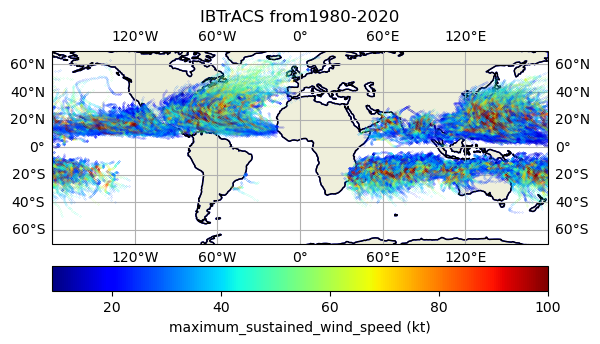

In [10]:
%%time
#https://case-studies.readthedocs.io/en/latest/TC_Tracks_Intensity.html
# intensity
#https://blog.csdn.net/shayuxing/article/details/124006042

year_s = 1980
year_e = 2020

flnm_ib = '/glade/work/mingge/TC_DBS/IBTrACS.ALL.v04r00.nc'
ds = xr.open_dataset(flnm_ib)

lat = ds.usa_lat
lon = ds.usa_lon
wind10 = ds.usa_wind.data
stormYear = ds.season.data  # year based on season
number = ds.number.data
time2d = ds.iso_time.data
basin = ds.basin.data
basin1=basin[:,0]

tcmask = np.where((stormYear >= year_s) &(stormYear <= year_e))
latselect = lat[tcmask]
lonselect = lon[tcmask]
spdselect = wind10[tcmask]
timeselect = time2d[tcmask]
numberselect = number[tcmask]

# no fig
#fig, ax = plt.subplots(figsize=(12,8))

ax = plt.axes(projection=ccrs.PlateCarree())
#ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=-180))
ax.coastlines()
ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
ax.set_extent([-180, 180, -70, 70])

ax.add_feature(cfeature.OCEAN,  facecolor='white')
ax.set_title('IBTrACS from' + str(year_s) + '-' + str(year_e))
ax.add_feature(cfeature.LAND, edgecolor='b')

# Prepare color map based on vortex center maximum wind speed
cmap=plt.cm.jet
norm=co.Normalize(vmin=9, vmax=100)
colors=plt.cm.ScalarMappable(norm,cmap)
 
for ii in range(len(numberselect)):
    lat_all = np.array(latselect[ii,:])
    lat_1d = lat_all[~np.isnan(lat_all)]
    
    lon_1d = np.array(lonselect[ii,:]) 
    lon_1d = lon_1d[~np.isnan(lat_all)]

    spd_1d = np.array(spdselect[ii,:])
    spd_1d = spd_1d[~np.isnan(lat_all)]
     
    if len(lon_1d)>0:
        col=colors.to_rgba(spd_1d)
        #print(col.max(), col.min(), type(col))
        if (lon_1d.max() - lon_1d.min()) >180:
            # discontinue at longitude 0
            lon_1d =np.where(lon_1d < 0, lon_1d+360, lon_1d)
        for nn in range(len(lon_1d)):      
            #ax.plot(lon_1d, lat_1d, color='k', linewidth=0.1, transform=ccrs.PlateCarree())
            ax.plot(lon_1d[nn], lat_1d[nn],  marker='.', markersize=0.2, color=col[nn,:], transform=ccrs.PlateCarree())
plt.colorbar(colors,fraction=0.1, pad=0.06,label='maximum_sustained_wind_speed (kt)', orientation='horizontal')   
 

CPU times: user 9.33 s, sys: 116 ms, total: 9.45 s
Wall time: 10.4 s


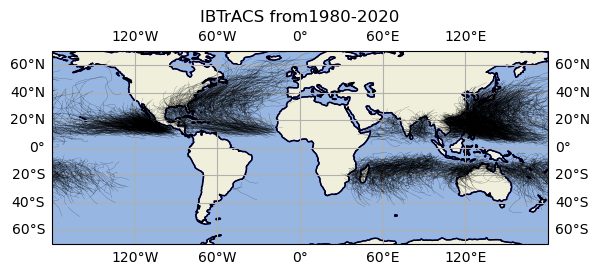

In [69]:
%%time
#https://blog.csdn.net/shayuxing/article/details/124006042

dir_data = '/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/'
dir_hr   = '/glade/campaign/mmm/c3we/done/pcast/CESM_HR/'
cat_name   = ['TD', 'TS', 'HU1', 'HU2', 'HU3', 'HU4','HU5']
cat_thresh = np.array([34.,   63.,   82.,   95.,   112., 136.])
ms2kt = 1.94384
flnms = [ff for ff in glob.glob(dir_data + "*WeakThreshold.txt")]
n_f = len(flnms)

year_s = 1980
year_e = 2020

flnm_ib = '/glade/work/mingge/TC_DBS/IBTrACS.ALL.v04r00.nc'
ds = xr.open_dataset(flnm_ib)

lat = ds.usa_lat
lon = ds.usa_lon
stormYear = ds.season.data  # year based on season
number = ds.number.data
time2d = ds.iso_time.data
basin = ds.basin.data
basin1 = basin[:,0]
tracktype = ds.track_type.data

tcmask = np.where((stormYear >= year_s) &(stormYear <= year_e)) # (basin1==b'NA') & (tracktype==b'main'))

latselect = lat[tcmask]
lonselect = lon[tcmask]
timeselect = time2d[tcmask]
numberselect = number[tcmask]

# no fig
#fig = plt.subplots(figsize=(12,8))

ax = plt.axes(projection=ccrs.PlateCarree())
#ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=-180))
ax.coastlines()
ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
ax.set_extent([-180, 180, -70, 70])

ax.add_feature(cfeature.OCEAN)
ax.set_title('IBTrACS from' + str(year_s) + '-' + str(year_e))
ax.add_feature(cfeature.LAND, edgecolor='b')

for ii in range(len(numberselect)):
    lat_1d = np.array(latselect[ii,:])
    lat_1d = lat_1d[~np.isnan(lat_1d)]
    lon_1d = np.array(lonselect[ii,:])
    lon_1d = lon_1d[~np.isnan(lon_1d)]
    if len(lon_1d)>0:
        if (lon_1d.max() - lon_1d.min()) >180:
            # discontinue at longitude 0
            lon_1d =np.where(lon_1d < 0, lon_1d+360, lon_1d)
            #print(lon_1d)
             
        ax.plot(lon_1d, lat_1d, color='k', linewidth=0.1, transform=ccrs.PlateCarree())
        #cb = ax.scatter(lon_1d, lat_1d, s=5, transform=ccrs.PlateCarree()) 

#### 2 WeakThreshold 100 member

In [ ]:
%%time
flnms = [ff for ff in glob.glob(dir_data + "*WeakThreshold.txt")]
n_f = len(flnms)

ax = plt.axes(projection=ccrs.PlateCarree())
ax.coastlines()
ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
ax.set_extent([-180, 180, -70, 70])
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAND, edgecolor='b')

    
ax.set_title('WeakThreshold 100 members')
    
# Prepare color map based on vortex center maximum wind speed
cmap=plt.cm.jet
norm=co.Normalize(vmin=9, vmax=100)
colors=plt.cm.ScalarMappable(norm,cmap)

for flnm in flnms:
    df_tc = pd.read_csv(flnm, delimiter=', ', engine='python')
    # drop rows containing 'year' in column year
    df_tc = df_tc[~df_tc.year.str.contains("year")]
    for year in range(year_s, year_e + 1):
        df = df_tc.loc[df_tc['year'].astype(int) == year]
        tc_ids = np.unique(df.track_id.astype(int))
        
        for tc_id in tc_ids:
            df_single = df.loc[df.track_id.astype(int) == tc_id]
             
            lat_1d = df_single.lat.values.astype(float) 
            lon_1d = df_single.lon.values.astype(float) 
            # discontinue at 180
            if  (lon_1d.max() - lon_1d.min()) >180:
                lon_1d =np.where(lon_1d > 180, lon_1d-360, lon_1d)

            spd_1d = df_single.wind10.values.astype(float)/kt2ms 
            col=colors.to_rgba(spd_1d)
            
            for nn in range(len(lon_1d)):      
                ax.plot(lon_1d[nn], lat_1d[nn],  marker='.', markersize=0.2, color=col[nn,:], transform=ccrs.PlateCarree())
plt.colorbar(colors,fraction=0.1, pad=0.06,label='maximum_sustained_wind_speed (kt)', orientation='horizontal')            


CPU times: user 2h 8min 54s, sys: 5min 59s, total: 2h 14min 53s
Wall time: 2h 42min 15s


CPU times: user 13min 10s, sys: 17 s, total: 13min 27s
Wall time: 14min 2s


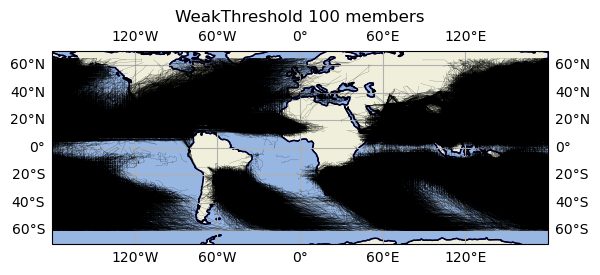

In [7]:
%%time
dir_data = '/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/'
flnms = [ff for ff in glob.glob(dir_data + "*WeakThreshold.txt")]
n_f = len(flnms)

year_s = 1980
year_e = 2020

ax = plt.axes(projection=ccrs.PlateCarree())
ax.coastlines()
ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
ax.set_extent([-180, 180, -70, 70])
ax.add_feature(cfeature.OCEAN)
ax.add_feature(cfeature.LAND, edgecolor='b')
    
ax.set_title('WeakThreshold 100 members')
        
for flnm in flnms:
    #print(flnm)  
    df_tc = pd.read_csv(flnm, delimiter=', ', engine='python')
    # drop rows containing 'year' in column year
    df_tc = df_tc[~df_tc.year.str.contains("year")]
    for year in range(year_s, year_e + 1):
        df = df_tc.loc[df_tc['year'].astype(int) == year]
        tc_ids = np.unique(df.track_id.astype(int))
        
        for tc_id in tc_ids:
            df_single = df.loc[df.track_id.astype(int) == tc_id]
             
            lat_1d = df_single.lat.values.astype(float) 
            lon_1d = df_single.lon.values.astype(float) 
            # discontinue at 180
            if  (lon_1d.max() - lon_1d.min()) >180:
                lon_1d =np.where(lon_1d > 180, lon_1d-360, lon_1d)
            
            ax.plot(lon_1d, lat_1d, color='k', linewidth=0.1, transform=ccrs.PlateCarree()) 
      

#### 3 for each member

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.010_1850-2100_WeakThreshold.txt


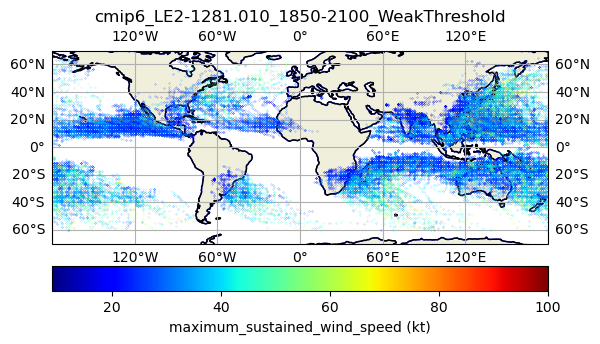

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.018_1850-2100_WeakThreshold.txt


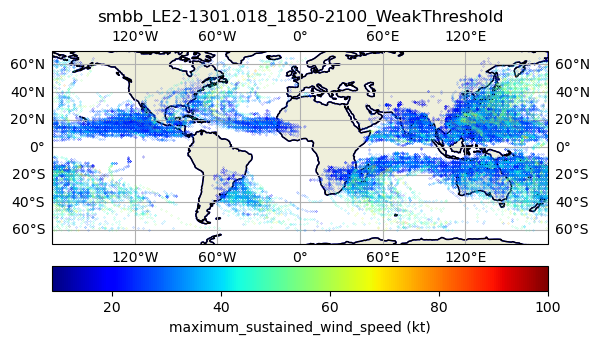

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.005_1850-2100_WeakThreshold.txt


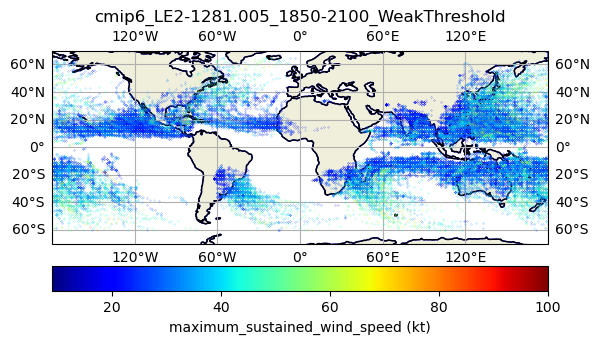

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.004_1850-2100_WeakThreshold.txt


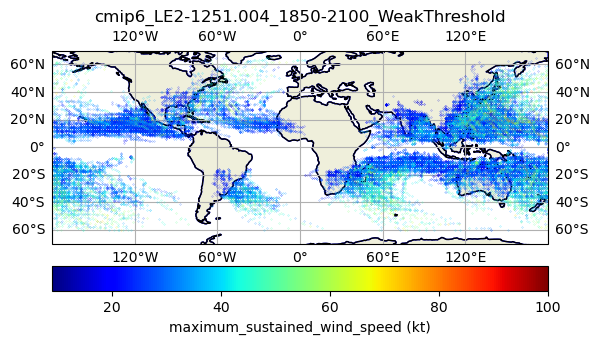

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.002_1850-2100_WeakThreshold.txt


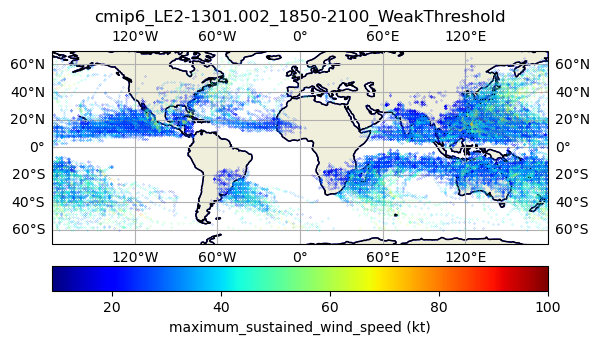

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1001.001_1850-2100_WeakThreshold.txt


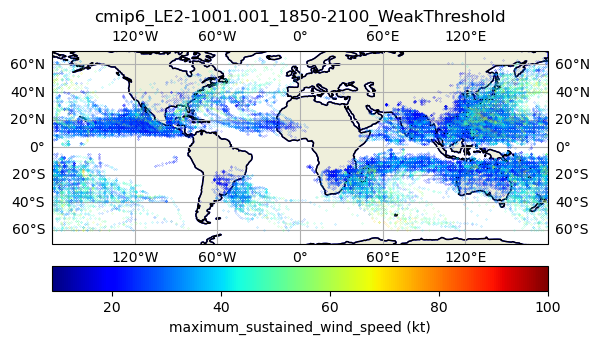

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.003_1850-2100_WeakThreshold.txt


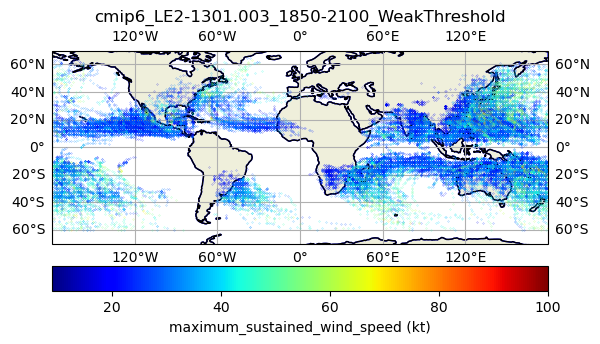

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.019_1850-2100_WeakThreshold.txt


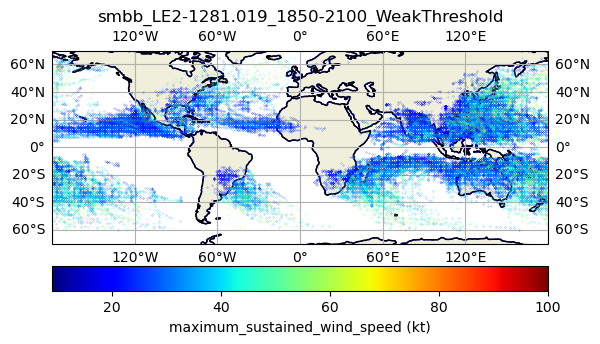

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1061.004_1850-2100_WeakThreshold.txt


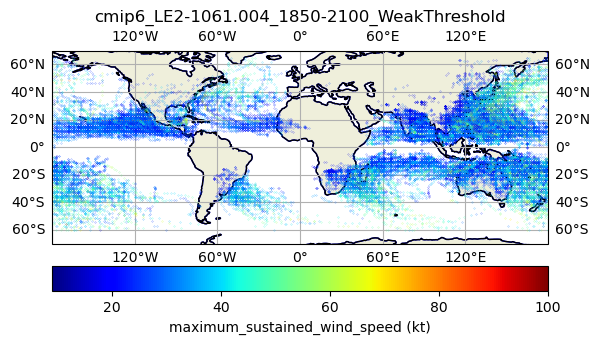

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.015_1850-2100_WeakThreshold.txt


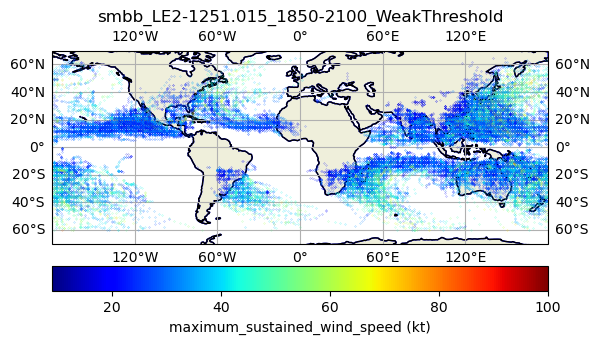

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1151.008_1850-2100_WeakThreshold.txt


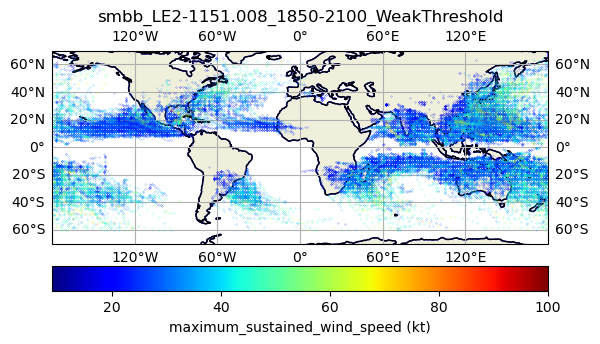

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.012_1850-2100_WeakThreshold.txt


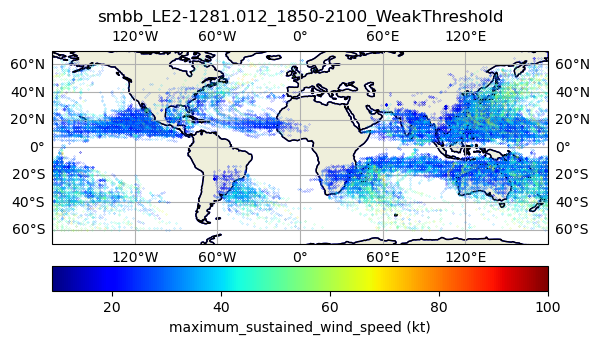

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1051.003_1850-2100_WeakThreshold.txt


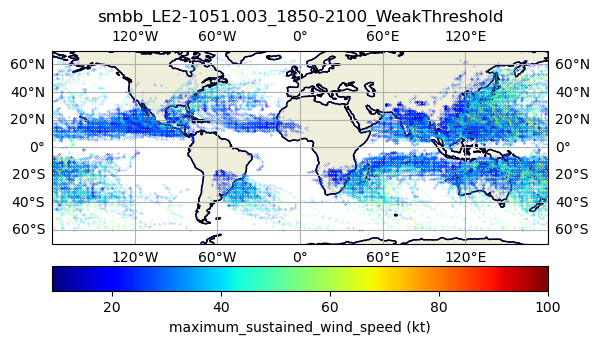

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.016_1850-2100_WeakThreshold.txt


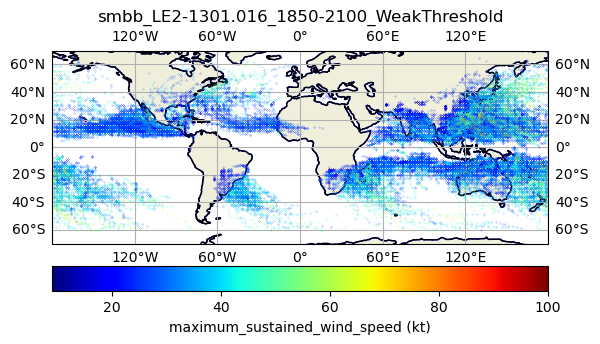

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.015_1850-2100_WeakThreshold.txt


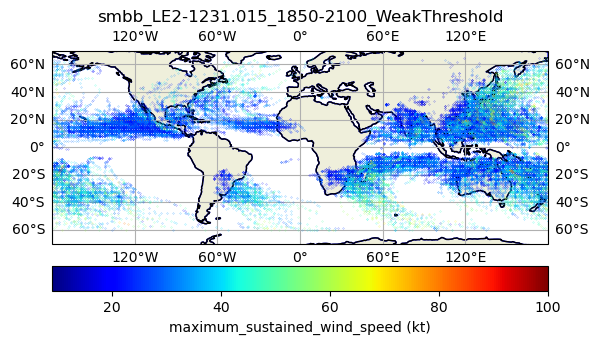

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.006_1850-2100_WeakThreshold.txt


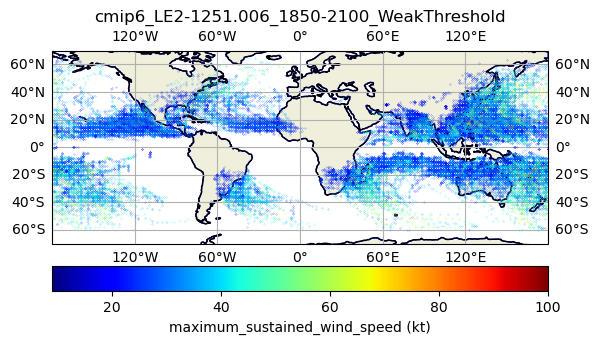

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.004_1850-2100_WeakThreshold.txt


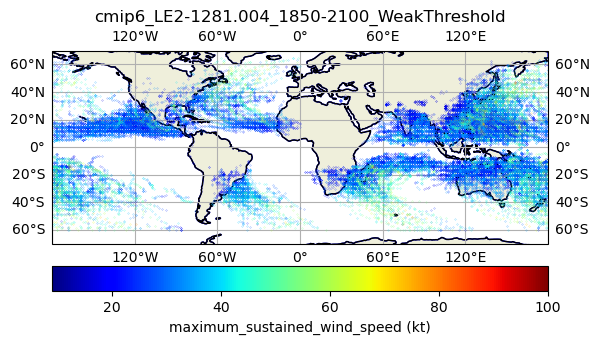

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1031.002_1850-2100_WeakThreshold.txt


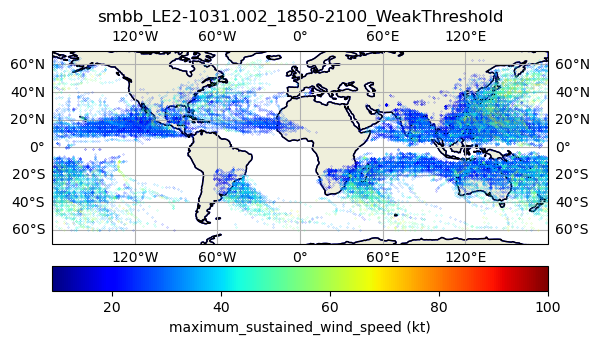

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.013_1850-2100_WeakThreshold.txt


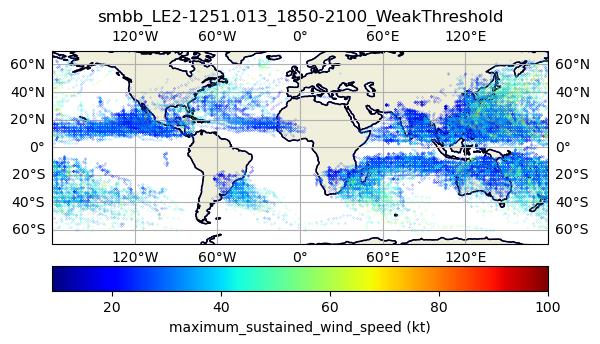

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.011_1850-2100_WeakThreshold.txt


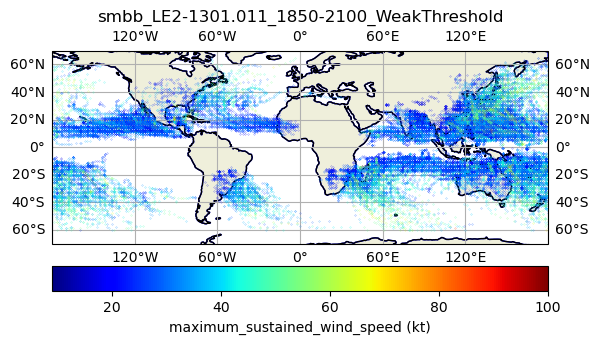

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.003_1850-2100_WeakThreshold.txt


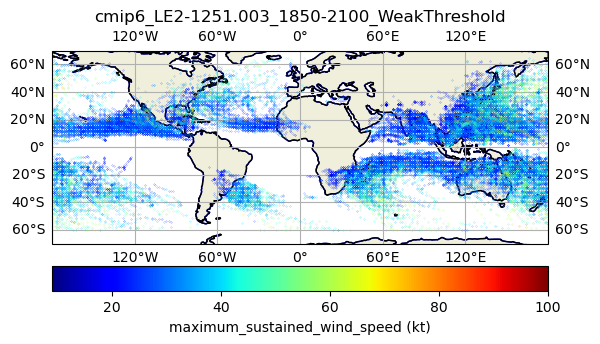

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.014_1850-2100_WeakThreshold.txt


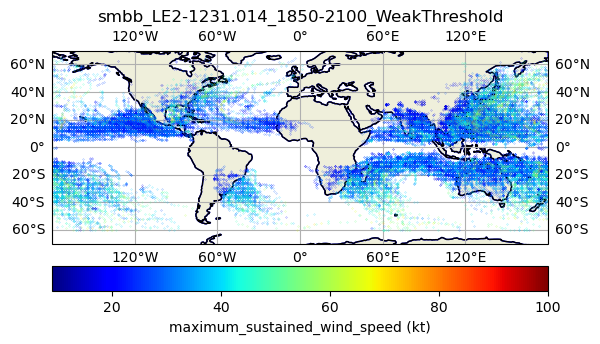

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.016_1850-2100_WeakThreshold.txt


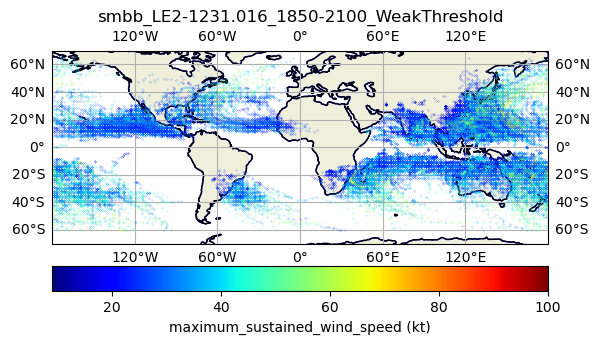

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1091.005_1850-2100_WeakThreshold.txt


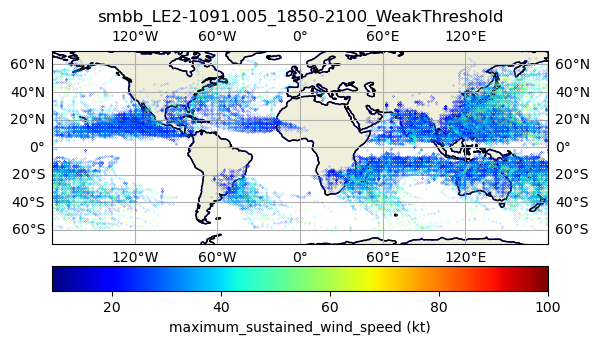

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.015_1850-2100_WeakThreshold.txt


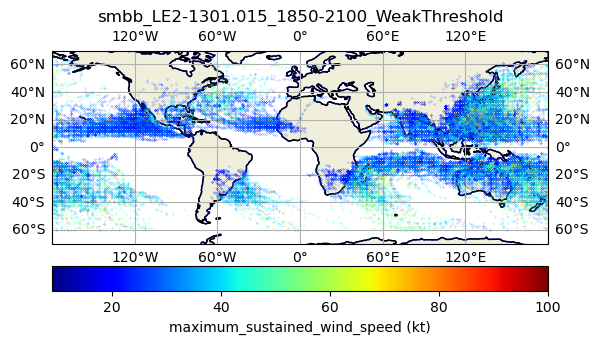

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.002_1850-2100_WeakThreshold.txt


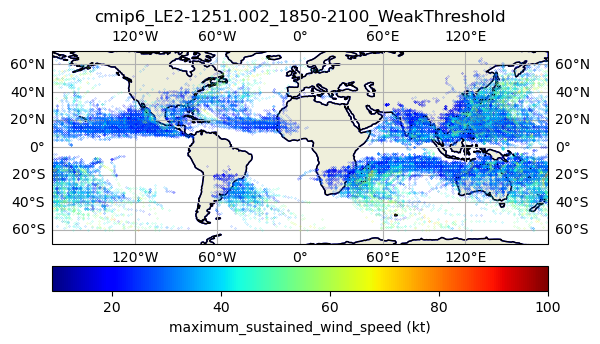

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1141.008_1850-2100_WeakThreshold.txt


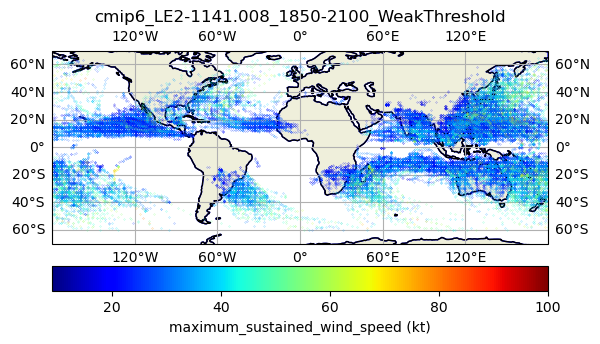

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.008_1850-2100_WeakThreshold.txt


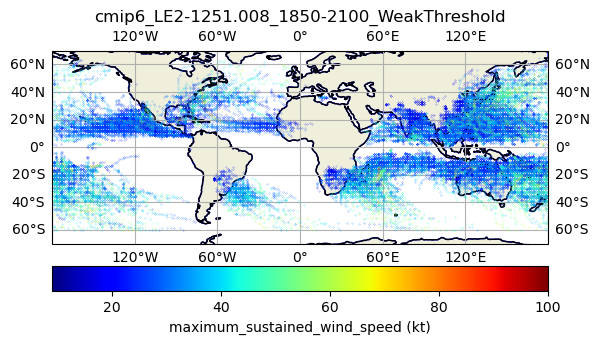

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.010_1850-2100_WeakThreshold.txt


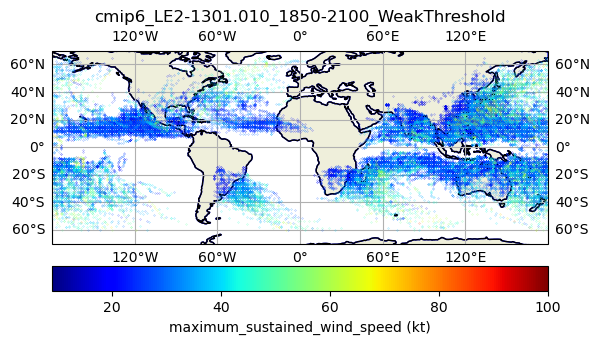

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1011.001_1850-2100_WeakThreshold.txt


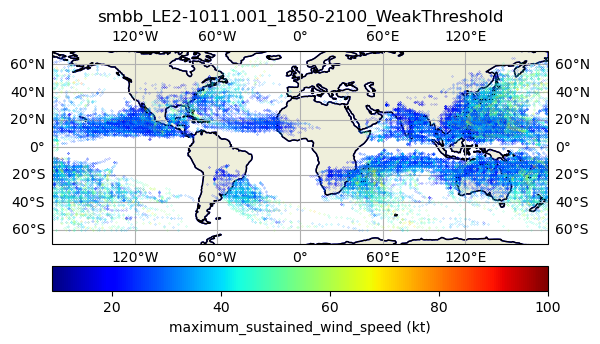

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.008_1850-2100_WeakThreshold.txt


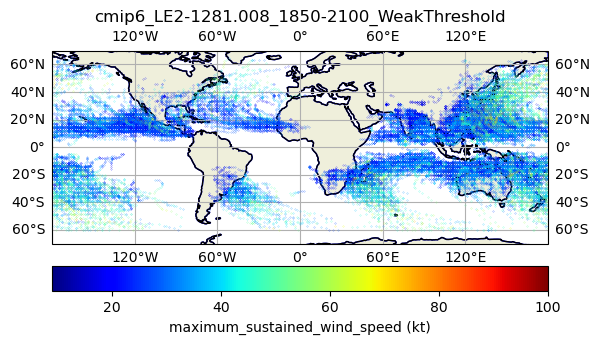

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.011_1850-2100_WeakThreshold.txt


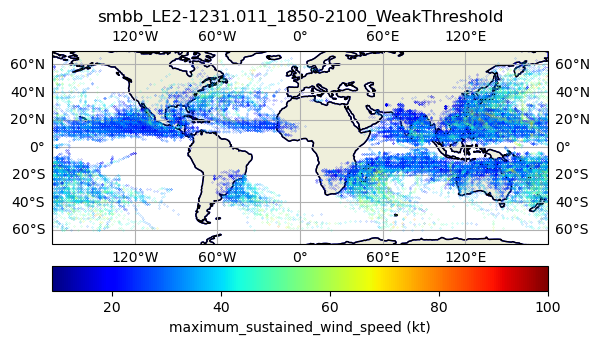

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.009_1850-2100_WeakThreshold.txt


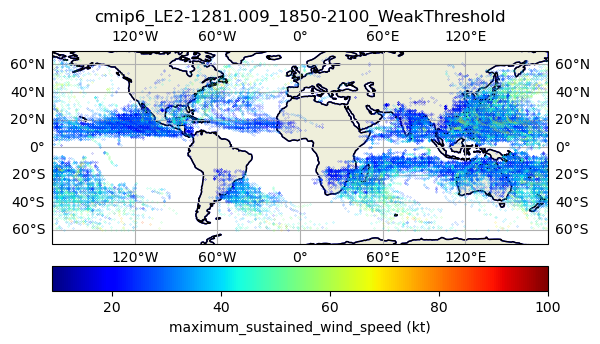

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.001_1850-2100_WeakThreshold.txt


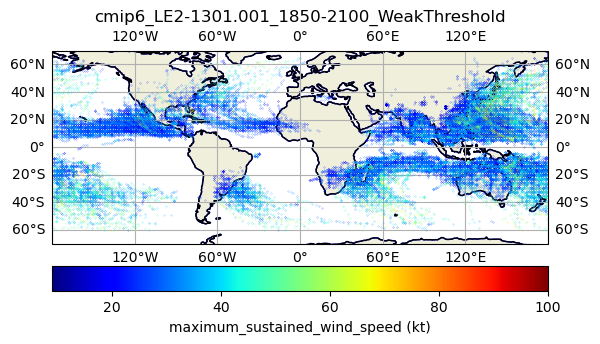

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.007_1850-2100_WeakThreshold.txt


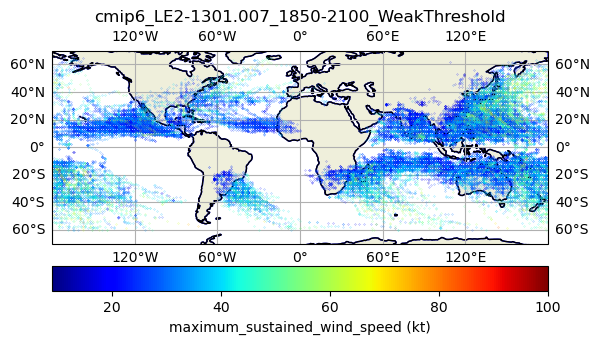

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.019_1850-2100_WeakThreshold.txt


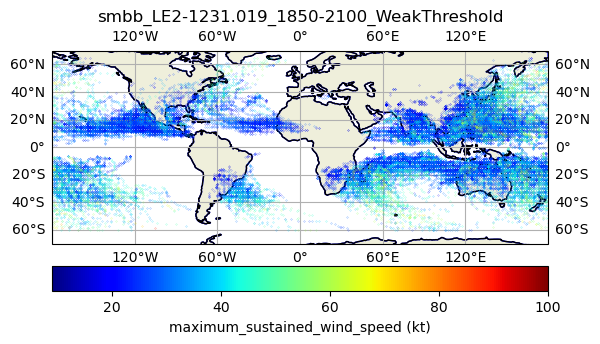

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.012_1850-2100_WeakThreshold.txt


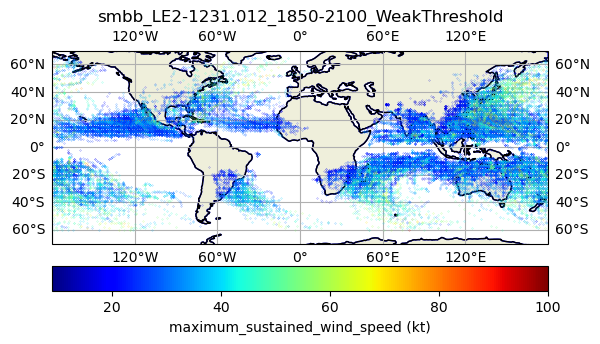

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.010_1850-2100_WeakThreshold.txt


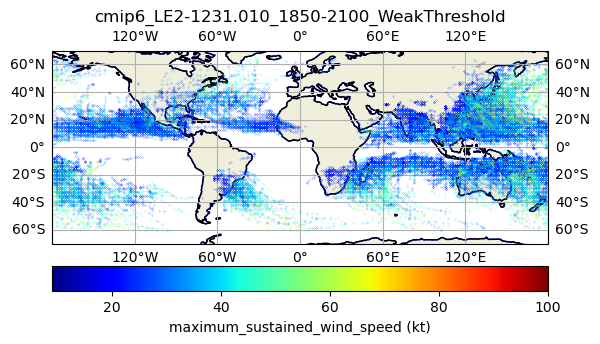

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.003_1850-2100_WeakThreshold.txt


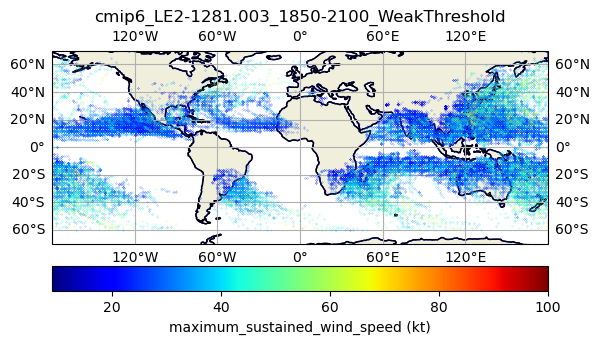

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.018_1850-2100_WeakThreshold.txt


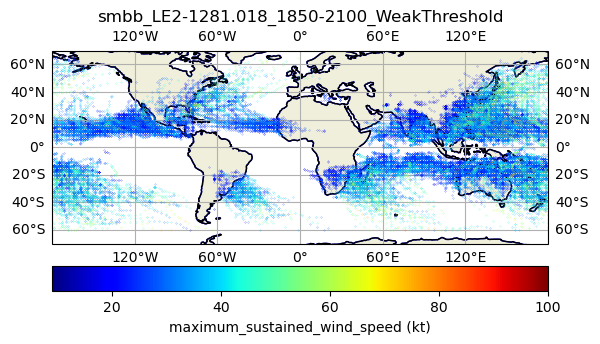

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.010_1850-2100_WeakThreshold.txt


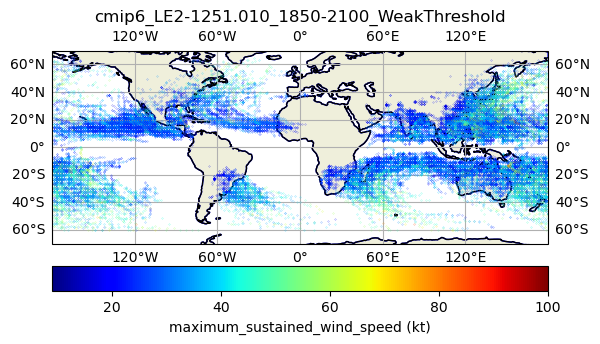

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.004_1850-2100_WeakThreshold.txt


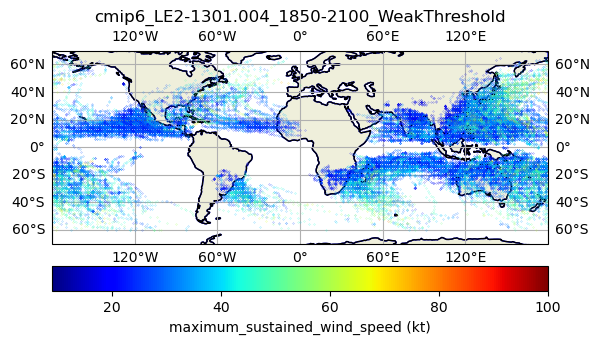

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.005_1850-2100_WeakThreshold.txt


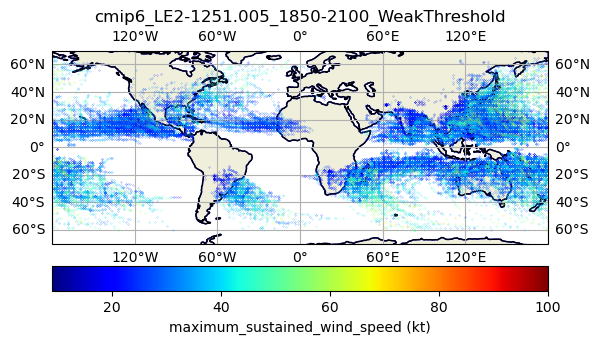

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1161.009_1850-2100_WeakThreshold.txt


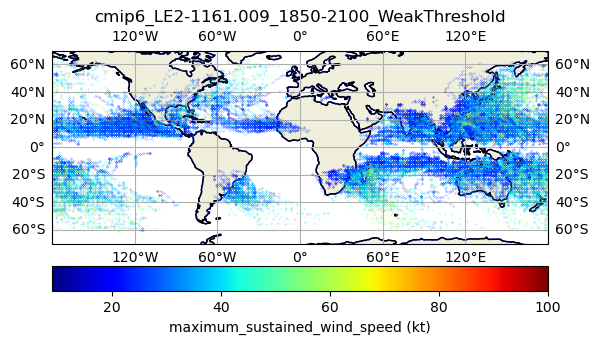

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.007_1850-2100_WeakThreshold.txt


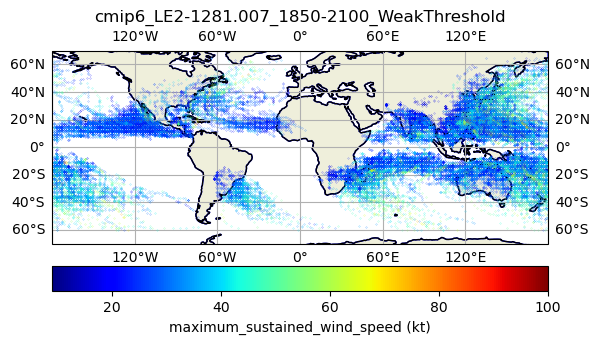

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.014_1850-2100_WeakThreshold.txt


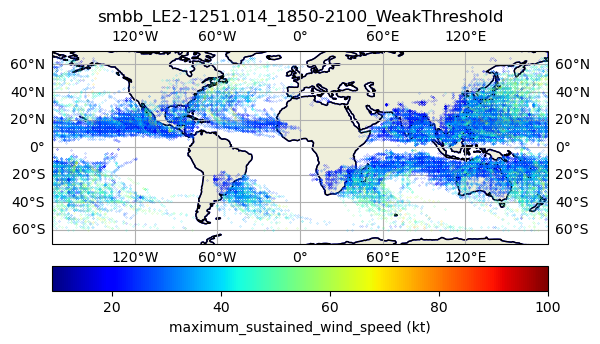

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.017_1850-2100_WeakThreshold.txt


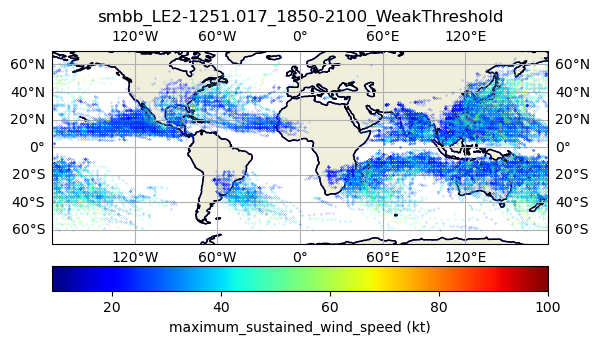

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.015_1850-2100_WeakThreshold.txt


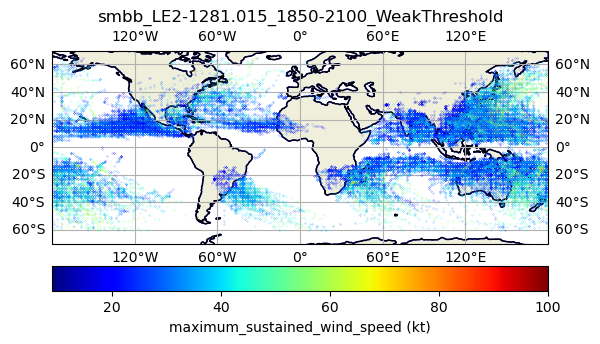

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.002_1850-2100_WeakThreshold.txt


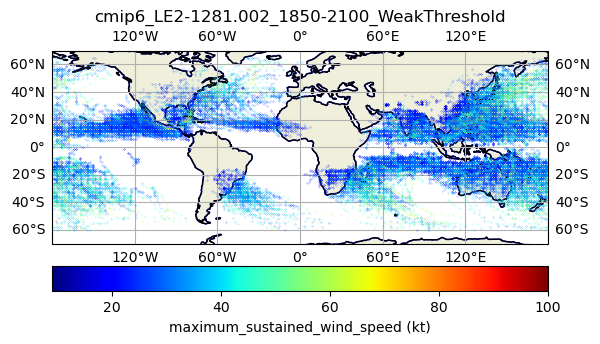

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.009_1850-2100_WeakThreshold.txt


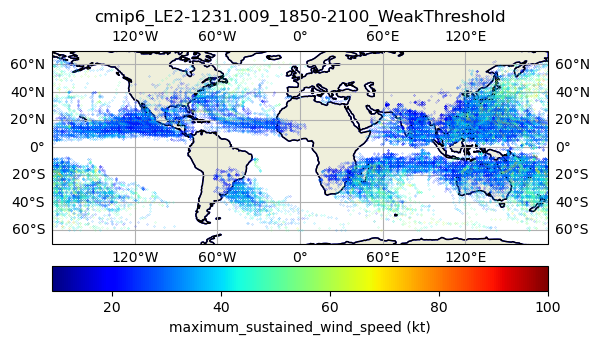

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.016_1850-2100_WeakThreshold.txt


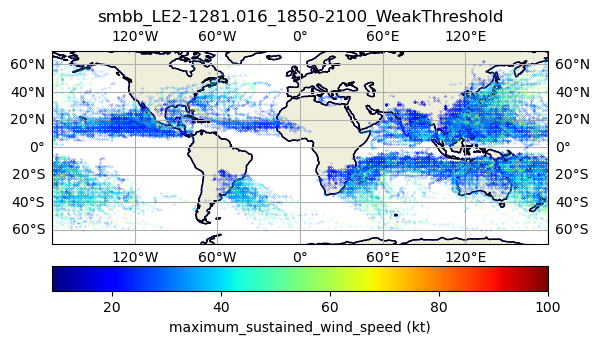

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.018_1850-2100_WeakThreshold.txt


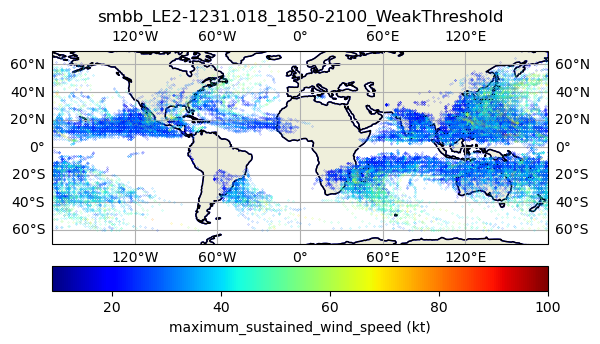

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.001_1850-2100_WeakThreshold.txt


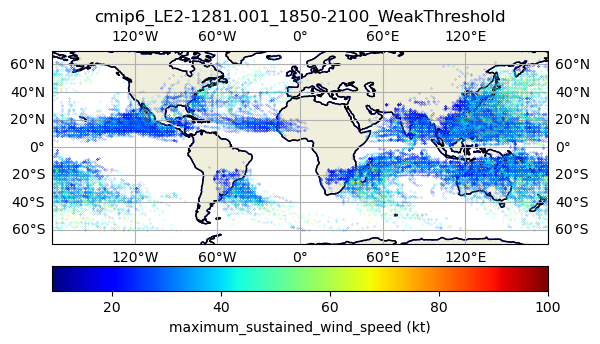

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.009_1850-2100_WeakThreshold.txt


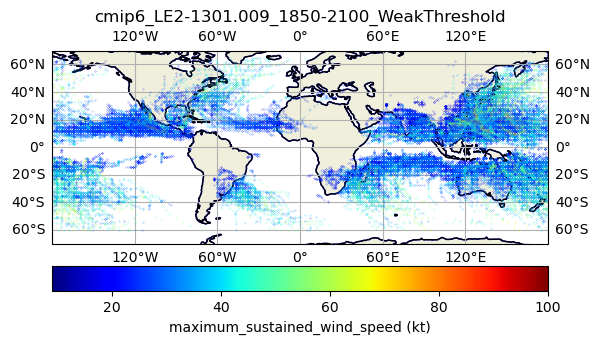

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1101.006_1850-2100_WeakThreshold.txt


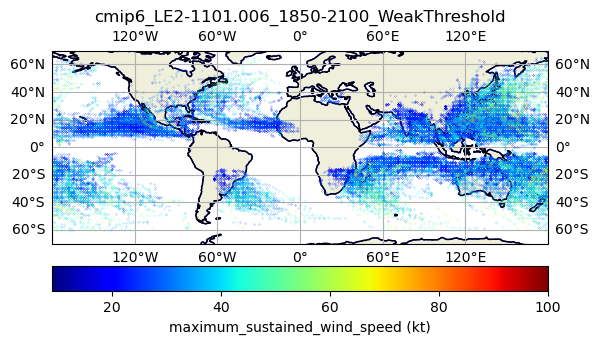

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1171.009_1850-2100_WeakThreshold.txt


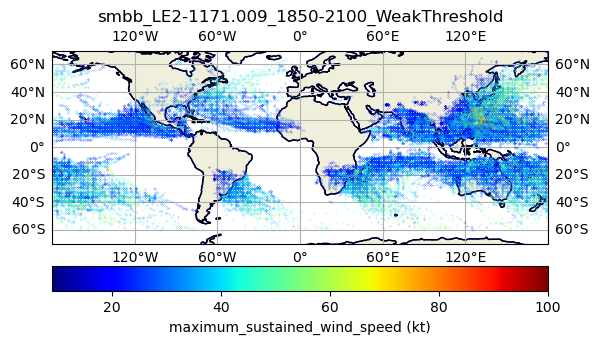

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.017_1850-2100_WeakThreshold.txt


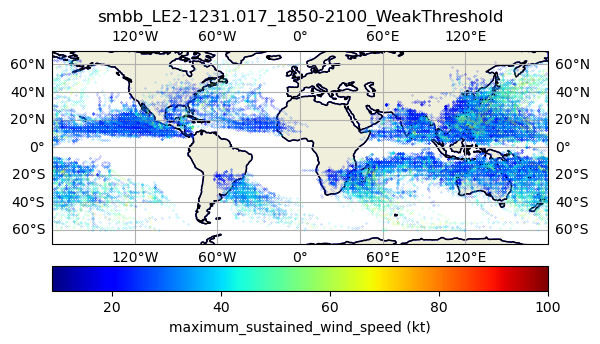

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.007_1850-2100_WeakThreshold.txt


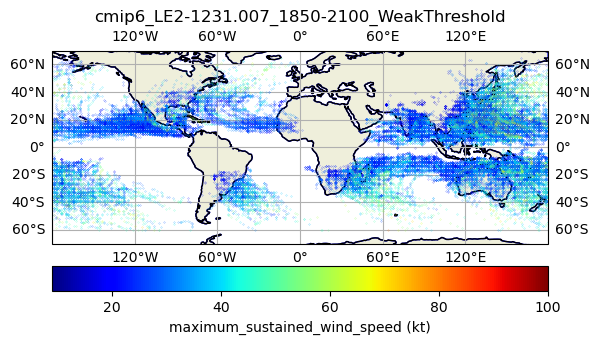

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1021.002_1850-2100_WeakThreshold.txt


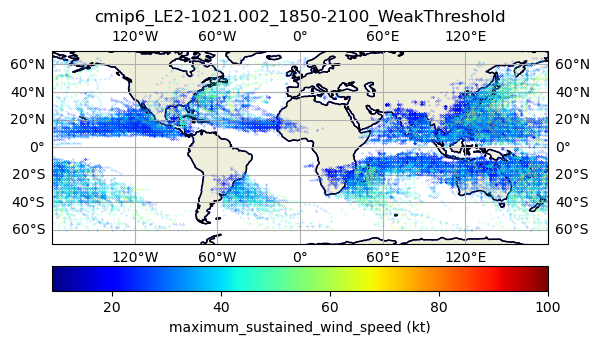

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.012_1850-2100_WeakThreshold.txt


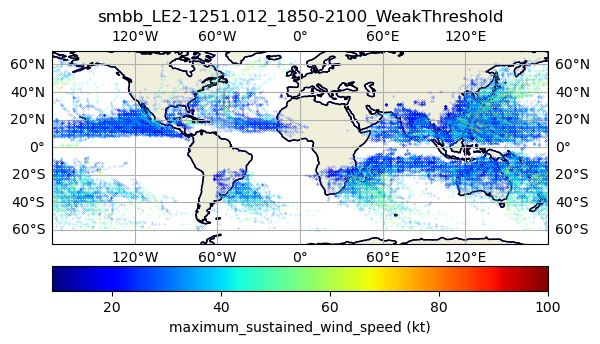

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.008_1850-2100_WeakThreshold.txt


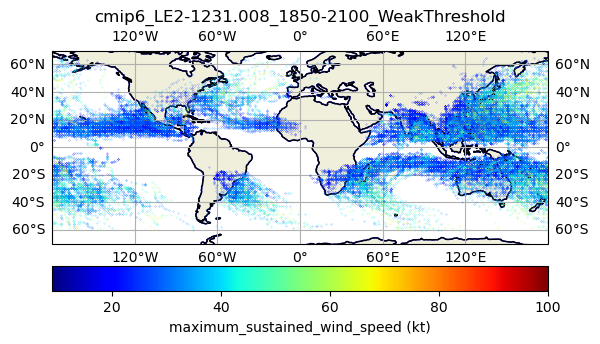

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.019_1850-2100_WeakThreshold.txt


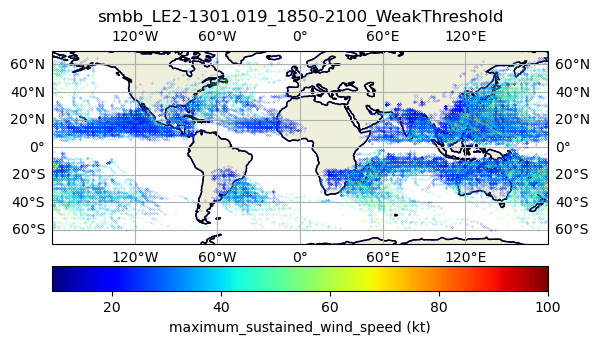

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.004_1850-2100_WeakThreshold.txt


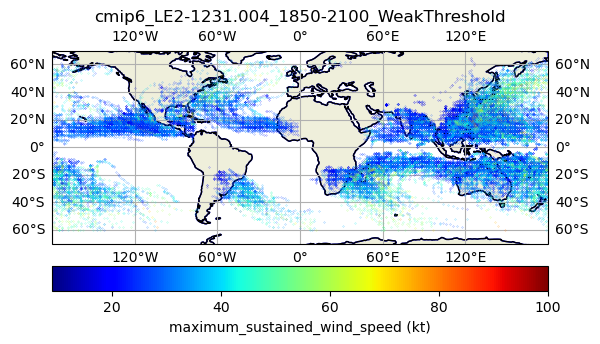

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.013_1850-2100_WeakThreshold.txt


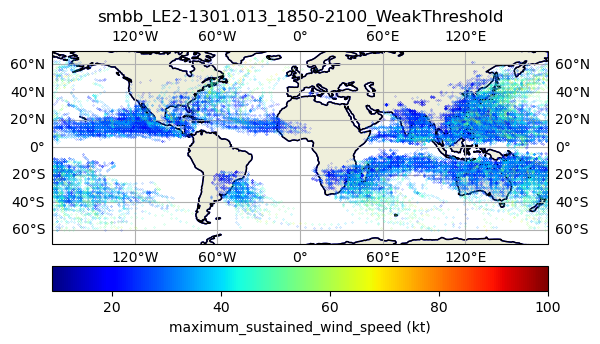

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1041.003_1850-2100_WeakThreshold.txt


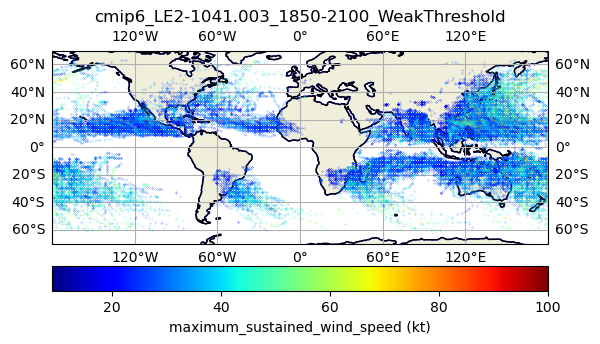

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1081.005_1850-2100_WeakThreshold.txt


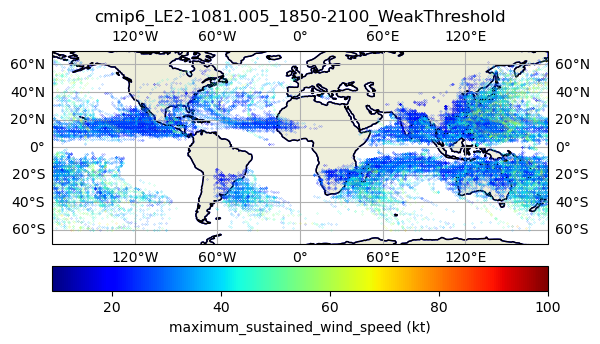

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1121.007_1850-2100_WeakThreshold.txt


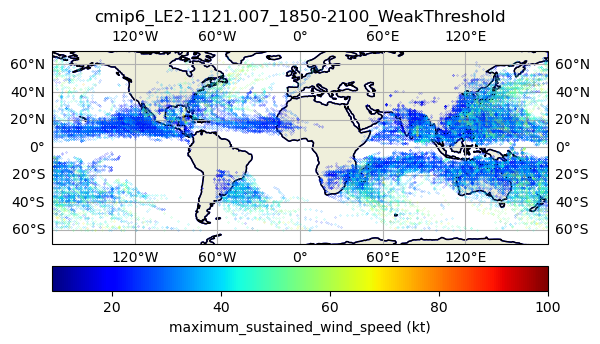

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.011_1850-2100_WeakThreshold.txt


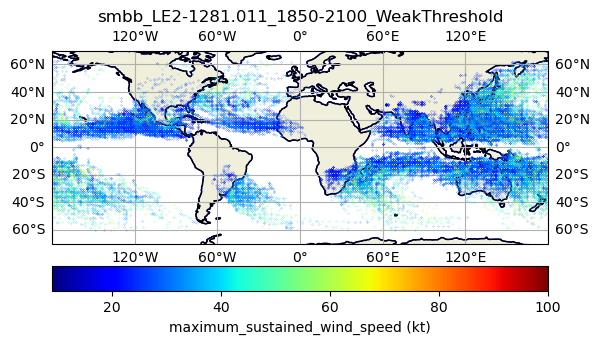

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.006_1850-2100_WeakThreshold.txt


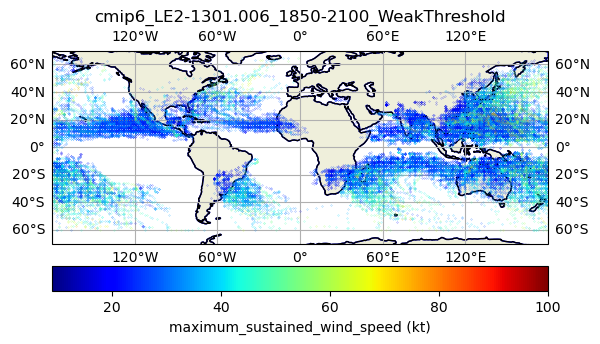

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.011_1850-2100_WeakThreshold.txt


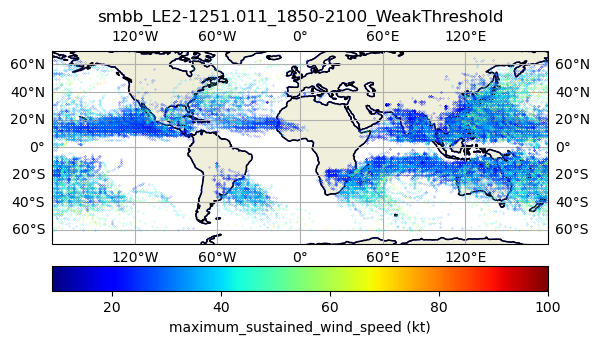

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.009_1850-2100_WeakThreshold.txt


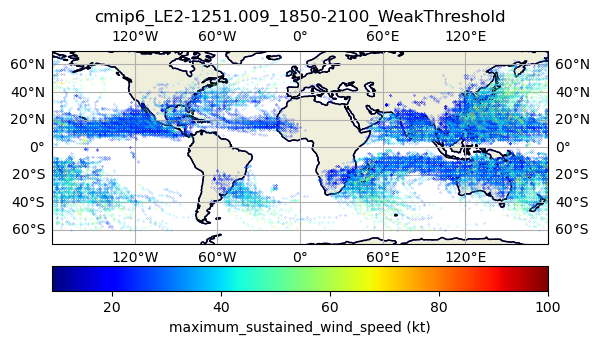

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.013_1850-2100_WeakThreshold.txt


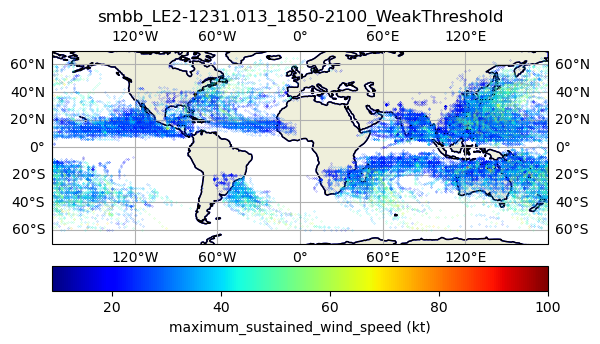

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.020_1850-2100_WeakThreshold.txt


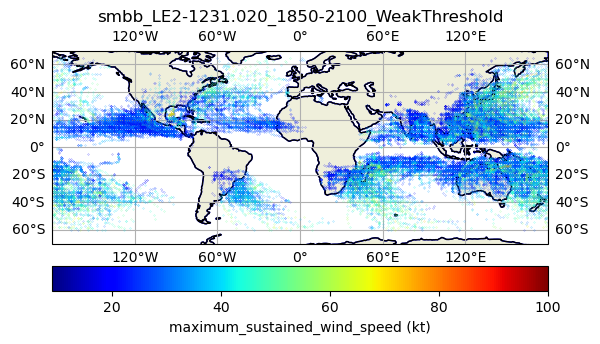

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.014_1850-2100_WeakThreshold.txt


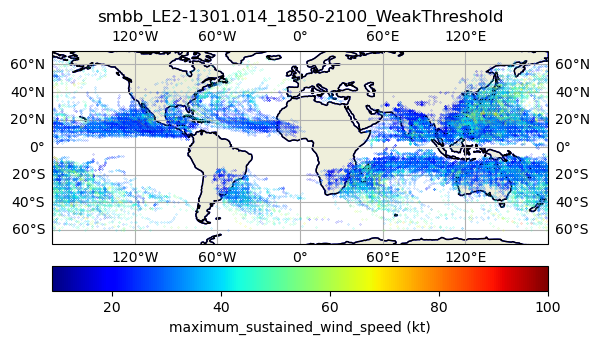

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.005_1850-2100_WeakThreshold.txt


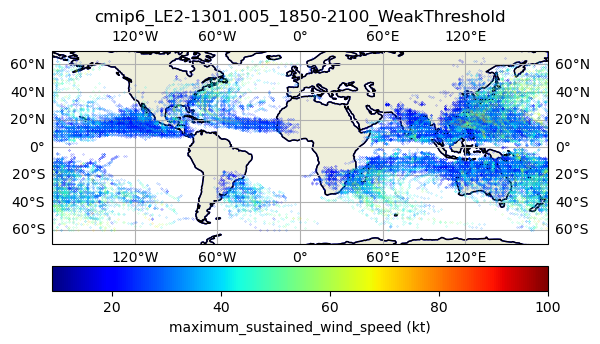

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.001_1850-2100_WeakThreshold.txt


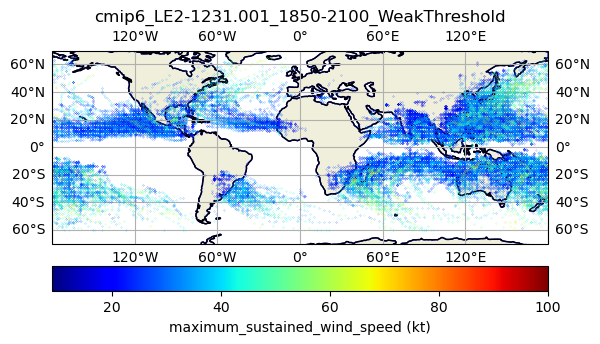

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.014_1850-2100_WeakThreshold.txt


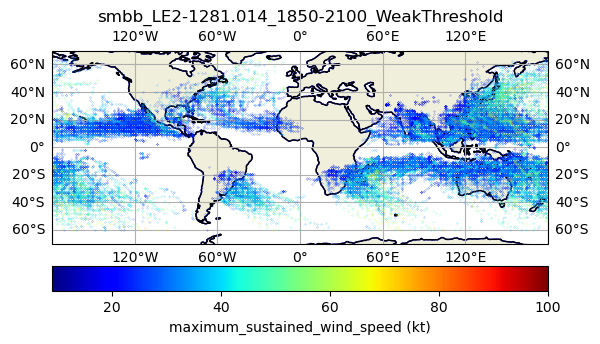

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1181.010_1850-2100_WeakThreshold.txt


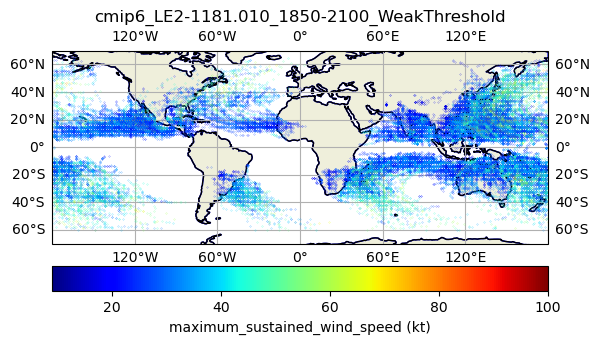

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.008_1850-2100_WeakThreshold.txt


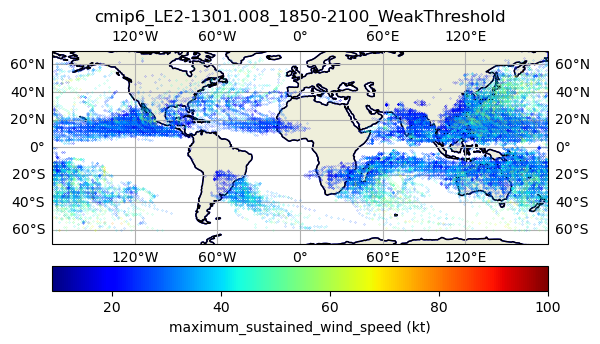

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.005_1850-2100_WeakThreshold.txt


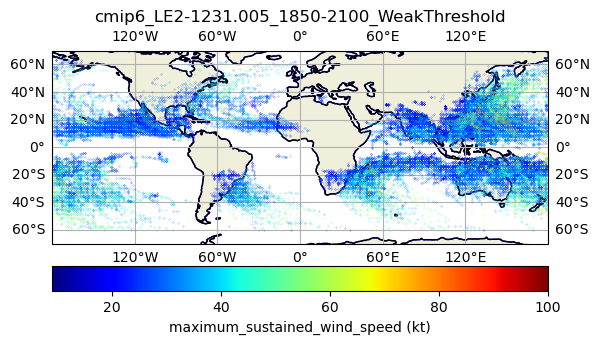

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1191.010_1850-2100_WeakThreshold.txt


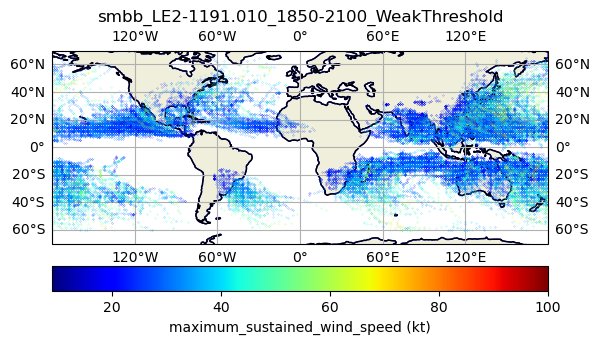

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.020_1850-2100_WeakThreshold.txt


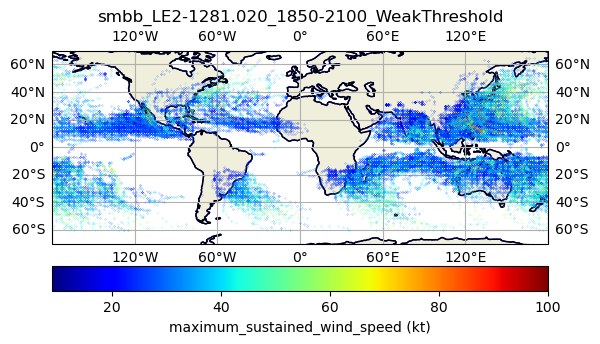

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.019_1850-2100_WeakThreshold.txt


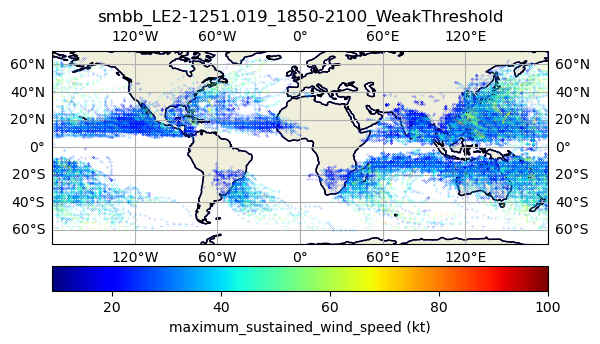

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.017_1850-2100_WeakThreshold.txt


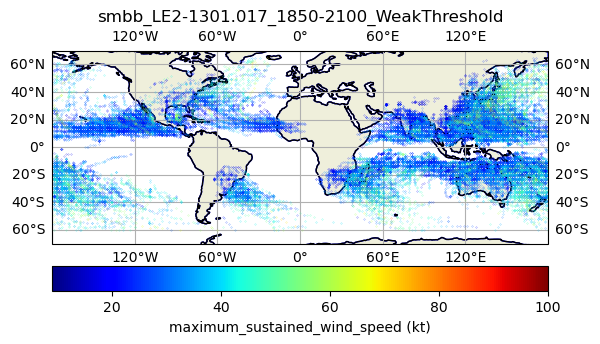

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.017_1850-2100_WeakThreshold.txt


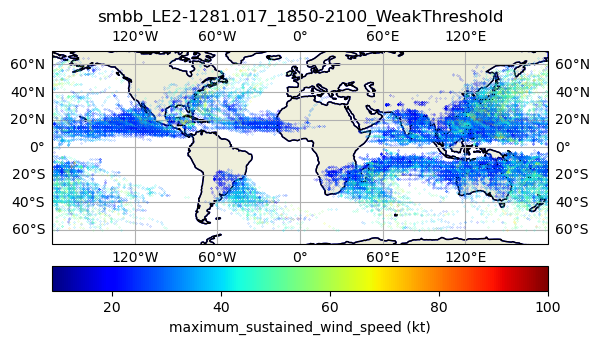

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.020_1850-2100_WeakThreshold.txt


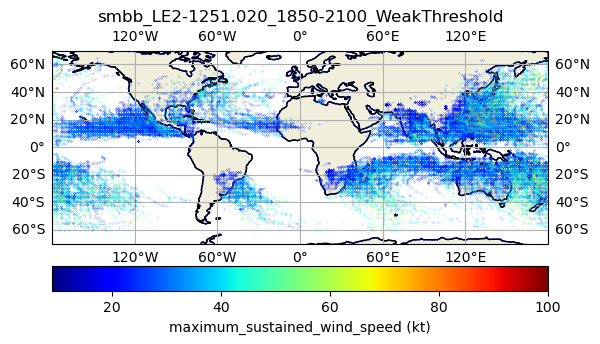

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.007_1850-2100_WeakThreshold.txt


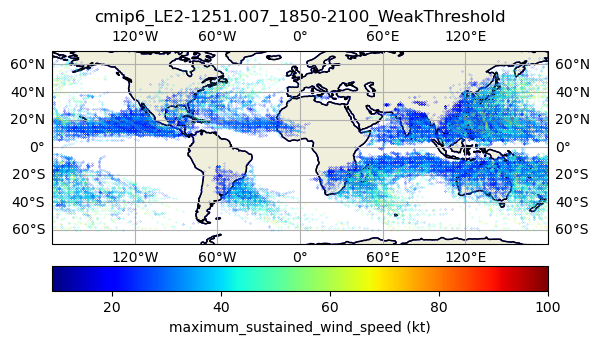

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.001_1850-2100_WeakThreshold.txt


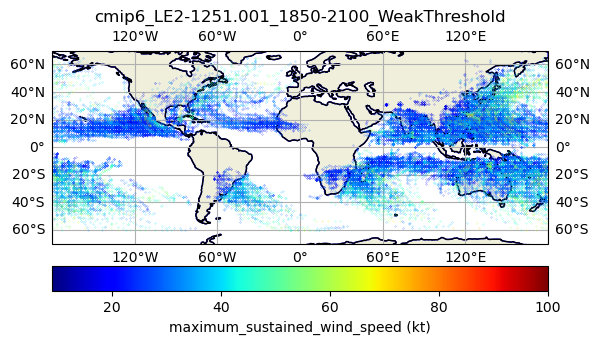

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1111.006_1850-2100_WeakThreshold.txt


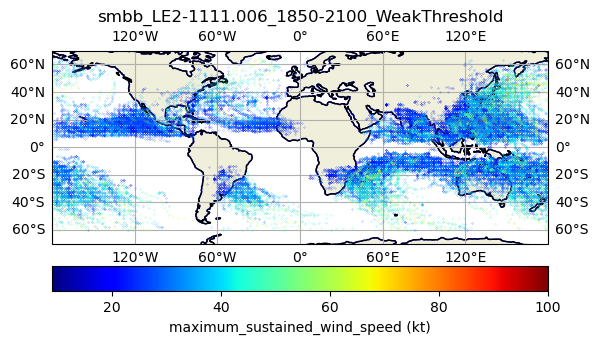

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1131.007_1850-2100_WeakThreshold.txt


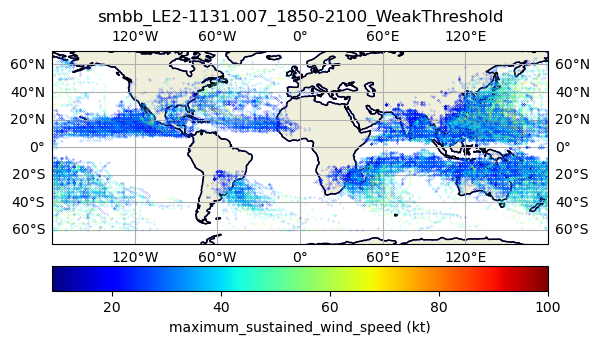

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.018_1850-2100_WeakThreshold.txt


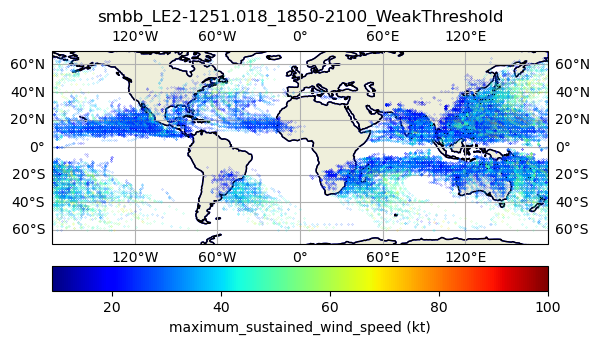

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.013_1850-2100_WeakThreshold.txt


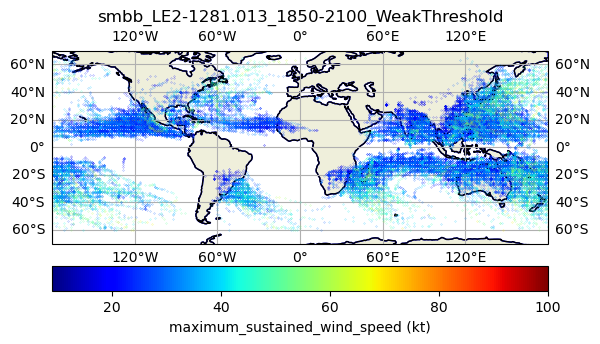

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.003_1850-2100_WeakThreshold.txt


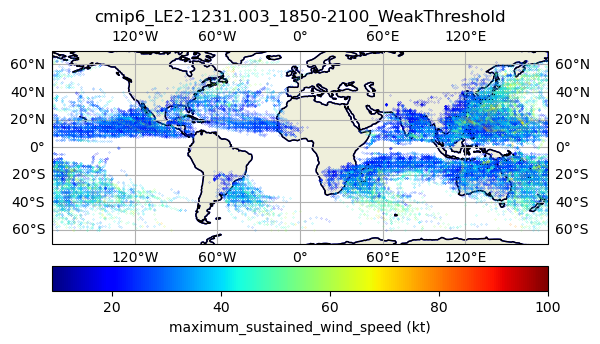

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.020_1850-2100_WeakThreshold.txt


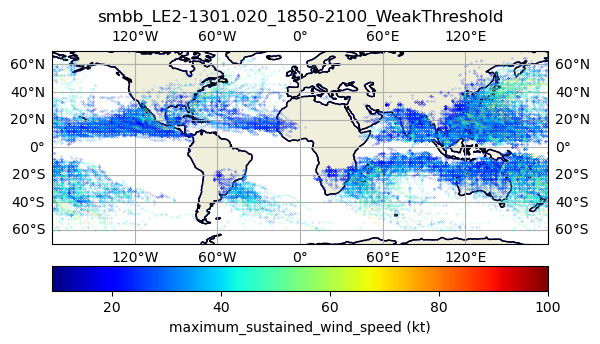

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.006_1850-2100_WeakThreshold.txt


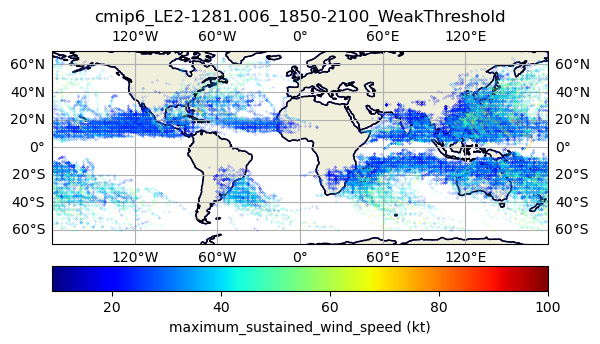

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.016_1850-2100_WeakThreshold.txt


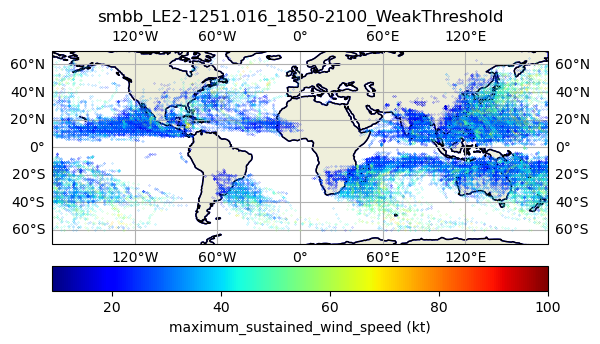

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.006_1850-2100_WeakThreshold.txt


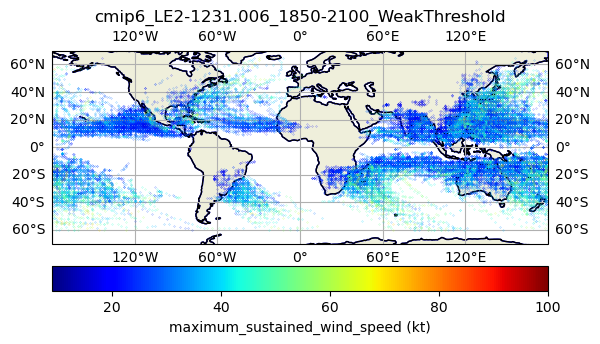

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1071.004_1850-2100_WeakThreshold.txt


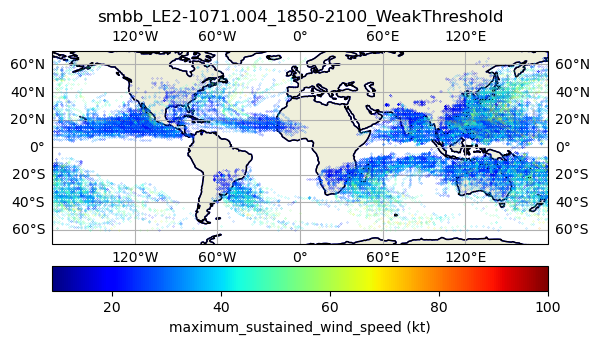

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.002_1850-2100_WeakThreshold.txt


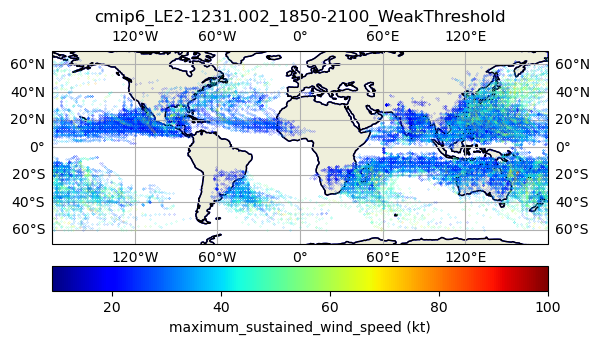

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.012_1850-2100_WeakThreshold.txt


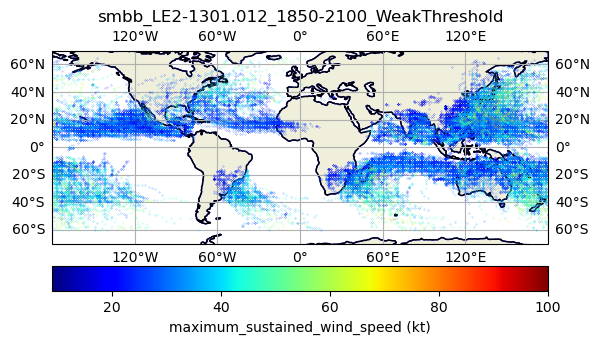

In [13]:
dir_data = '/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/'
flnms = [ff for ff in glob.glob(dir_data + "*WeakThreshold.txt")]
n_f = len(flnms)

year_s = 1980
year_e = 2020

# Prepare color map based on vortex center maximum wind speed
cmap=plt.cm.jet
norm=co.Normalize(vmin=9, vmax=100)
colors=plt.cm.ScalarMappable(norm,cmap)

for flnm in flnms:
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.coastlines()
    ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
    ax.set_extent([-180, 180, -70, 70])
    ax.add_feature(cfeature.OCEAN,facecolor='white')
    ax.add_feature(cfeature.LAND, edgecolor='b')

    print(flnm)
    ax.set_title(flnm[len(dir_data)+11:-4])
    df_tc = pd.read_csv(flnm, delimiter=', ', engine='python')
    # drop rows containing 'year' in column year
    df_tc = df_tc[~df_tc.year.str.contains("year")]
    
    years = df_tc.year
    years = np.unique(years)
   
    for year in range(year_s, year_e + 1):
        df = df_tc.loc[df_tc['year'].astype(int) == year]
        tc_ids = np.unique(df.track_id.astype(int))
        
        for tc_id in tc_ids:
            df_single = df.loc[df.track_id.astype(int) == tc_id]
             
            lat_1d = df_single.lat.values.astype(float) 
            lon_1d = df_single.lon.values.astype(float) 
            spd_1d = df_single.wind10.values.astype(float)/kt2ms  
            
            # discontinue at 180
            if  (lon_1d.max() - lon_1d.min()) >180:
                lon_1d =np.where(lon_1d > 180, lon_1d-360, lon_1d)
            
            col=colors.to_rgba(spd_1d)          
            #ax.plot(lon_1d, lat_1d, color='k', linewidth=0.1, transform=ccrs.PlateCarree()) 
     
            for nn in range(len(lon_1d)):        
                ax.plot(lon_1d[nn], lat_1d[nn],  marker='.', markersize=0.3, color=col[nn,:], transform=ccrs.PlateCarree())
    plt.colorbar(colors,fraction=0.1, pad=0.06,label='maximum_sustained_wind_speed (kt)', orientation='horizontal')            
    plt.show()
    

In [11]:
kt2ms 

0.514444